# Educational Process Mining

https://archive-beta.ics.uci.edu/dataset/346/educational+process+mining+epm+a+learning+analytics+data+set

Educational Process Mining (EPM): A Learning Analytics Data Set. (2015). UCI Machine Learning Repository.

## Visualizations for Logistic Regression to model intermediate scores as pass/fail event

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns

In [2]:
from IPython.display import Image, display

## Include functions
CMPINF2120_EPM_FUNC_INCL_Over_Lisa.ipynb includes functions used in this notebook.

In [3]:
%run CMPINF2120_EPM_FUNC_INCL_Over_Lisa.ipynb

## Load the data from github repository

In [4]:
interim_sqrt_path = 'https://raw.githubusercontent.com/lisaover/CMPINF2120_project/main/tp_sqrt_inputs_interim_df.csv'

In [5]:
interim_sqrt_init = pd.read_csv(interim_sqrt_path)

In [6]:
interim_sqrt_init.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3642 entries, 0 to 3641
Data columns (total 83 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   sess                 3642 non-null   int64  
 1   sid                  3642 non-null   int64  
 2   actv_grp             3642 non-null   object 
 3   total_ms_tp000_sqrt  3642 non-null   float64
 4   mw_tp000_sqrt        3642 non-null   float64
 5   mwc_tp000_sqrt       3642 non-null   float64
 6   mcl_tp000_sqrt       3642 non-null   float64
 7   mcr_tp000_sqrt       3642 non-null   float64
 8   mm_tp000_sqrt        3642 non-null   float64
 9   ks_tp000_sqrt        3642 non-null   float64
 10  total_ms_tp010_sqrt  3642 non-null   float64
 11  mw_tp010_sqrt        3642 non-null   float64
 12  mwc_tp010_sqrt       3642 non-null   float64
 13  mcl_tp010_sqrt       3642 non-null   float64
 14  mcr_tp010_sqrt       3642 non-null   float64
 15  mm_tp010_sqrt        3642 non-null   f

In [7]:
interim_sqrt_init.isna().sum()

sess                   0
sid                    0
actv_grp               0
total_ms_tp000_sqrt    0
mw_tp000_sqrt          0
                      ..
mm_tp100_sqrt          0
ks_tp100_sqrt          0
interim_scr            0
max_interim_scr        0
interim_pass           0
Length: 83, dtype: int64

interim_sqrt_init['sid'] = interim_sqrt_init['sid'].astype('object')
interim_sqrt_init['sess'] = interim_sqrt_init['sess'].astype('object')

In [8]:
interim_sqrt_df = interim_sqrt_init.copy()

In [9]:
sqrt_vars = get_var_list(interim_sqrt_df,['sqrt'])

In [10]:
totl_vars = get_var_list_b(interim_sqrt_df,['total'])
mw_vars = get_var_list_b(interim_sqrt_df,['mw_'])
mwc_vars = get_var_list_b(interim_sqrt_df,['mwc'])
mcl_vars = get_var_list_b(interim_sqrt_df,['mcl'])
mcr_vars = get_var_list_b(interim_sqrt_df,['mcr'])
mm_vars = get_var_list_b(interim_sqrt_df,['mm'])
ks_vars = get_var_list_b(interim_sqrt_df,['ks'])

In [11]:
features_df = interim_sqrt_df.loc[:, sqrt_vars].copy()

In [12]:
features_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3642 entries, 0 to 3641
Data columns (total 77 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   total_ms_tp000_sqrt  3642 non-null   float64
 1   mw_tp000_sqrt        3642 non-null   float64
 2   mwc_tp000_sqrt       3642 non-null   float64
 3   mcl_tp000_sqrt       3642 non-null   float64
 4   mcr_tp000_sqrt       3642 non-null   float64
 5   mm_tp000_sqrt        3642 non-null   float64
 6   ks_tp000_sqrt        3642 non-null   float64
 7   total_ms_tp010_sqrt  3642 non-null   float64
 8   mw_tp010_sqrt        3642 non-null   float64
 9   mwc_tp010_sqrt       3642 non-null   float64
 10  mcl_tp010_sqrt       3642 non-null   float64
 11  mcr_tp010_sqrt       3642 non-null   float64
 12  mm_tp010_sqrt        3642 non-null   float64
 13  ks_tp010_sqrt        3642 non-null   float64
 14  total_ms_tp020_sqrt  3642 non-null   float64
 15  mw_tp020_sqrt        3642 non-null   f

In [13]:
feature_names = features_df.columns

In [14]:
len(feature_names)

77

In [15]:
interim_sqrt_df = interim_sqrt_init.copy()

In [16]:
interim_sqrt_df.loc[interim_sqrt_df.sess==2].actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'Other', 'Properties',
       'Study', 'TextEditor', 'FSM_Related', 'Study_Materials'],
      dtype=object)

In [17]:
interim_sqrt_df.loc[interim_sqrt_df.sess==2].actv_grp.nunique()

10

In [18]:
interim_sqrt_df.loc[interim_sqrt_df.sess==3].actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'Other', 'Properties',
       'Study', 'TextEditor', 'FSM_Related', 'Study_Materials'],
      dtype=object)

In [19]:
interim_sqrt_df.loc[interim_sqrt_df.sess==3].actv_grp.nunique()

10

In [20]:
interim_sqrt_df.loc[interim_sqrt_df.sess==4].actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'FSM_Related', 'Other',
       'Properties', 'Study', 'TextEditor', 'Study_Materials'],
      dtype=object)

In [21]:
interim_sqrt_df.loc[interim_sqrt_df.sess==4].actv_grp.nunique()

10

In [22]:
interim_sqrt_df.loc[interim_sqrt_df.sess==5].actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'Other', 'Properties',
       'Study', 'TextEditor', 'Study_Materials', 'FSM_Related'],
      dtype=object)

In [23]:
interim_sqrt_df.loc[interim_sqrt_df.sess==5].actv_grp.nunique()

10

In [24]:
interim_sqrt_df.loc[interim_sqrt_df.sess==6].actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'FSM', 'FSM_Related',
       'Other', 'Properties', 'Study', 'TextEditor', 'Study_Materials'],
      dtype=object)

In [25]:
interim_sqrt_df.loc[interim_sqrt_df.sess==6].actv_grp.nunique()

11

## Visualizations

#### Bar charts compare the number of events to non-events

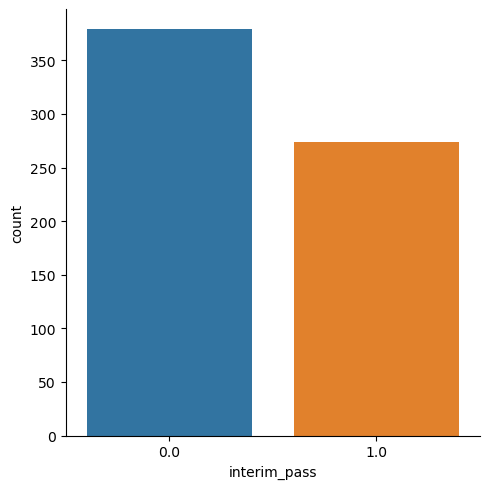

In [26]:
sns.catplot(data = interim_sqrt_df.loc[interim_sqrt_df['sess']==2], x='interim_pass', kind='count')

plt.show()

In [27]:
interim_sqrt_df.loc[interim_sqrt_df['sess']==2].interim_pass.mean()

0.41960183767228176

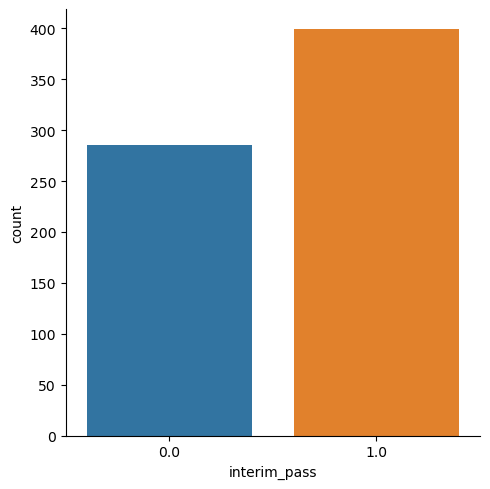

In [28]:
sns.catplot(data = interim_sqrt_df.loc[interim_sqrt_df['sess']==3], x='interim_pass', kind='count')

plt.show()

In [29]:
interim_sqrt_df.loc[interim_sqrt_df['sess']==3].interim_pass.mean()

0.5833333333333334

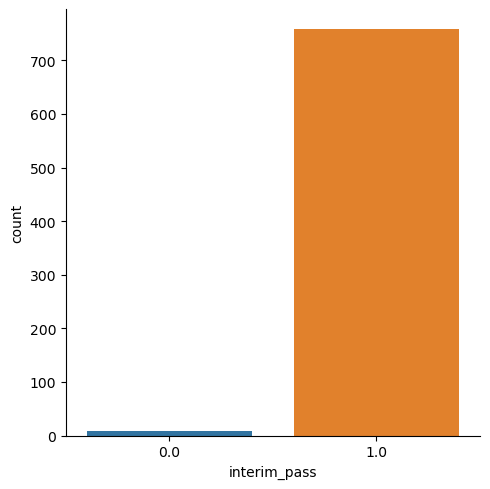

In [30]:
sns.catplot(data = interim_sqrt_df.loc[interim_sqrt_df['sess']==4], x='interim_pass', kind='count')

plt.show()

In [31]:
interim_sqrt_df.loc[interim_sqrt_df['sess']==4].interim_pass.mean()

0.9895561357702349

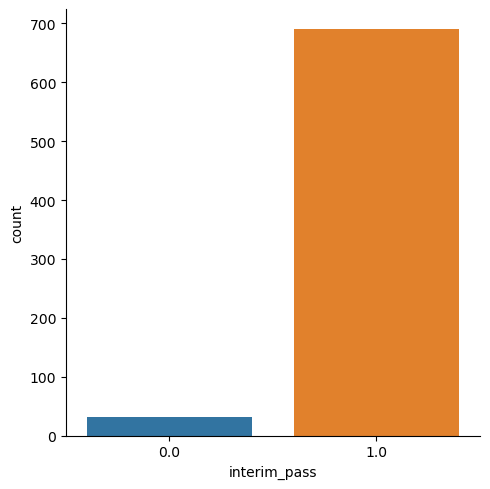

In [32]:
sns.catplot(data = interim_sqrt_df.loc[interim_sqrt_df['sess']==5], x='interim_pass', kind='count')

plt.show()

In [33]:
interim_sqrt_df.loc[interim_sqrt_df['sess']==5].interim_pass.mean()

0.957004160887656

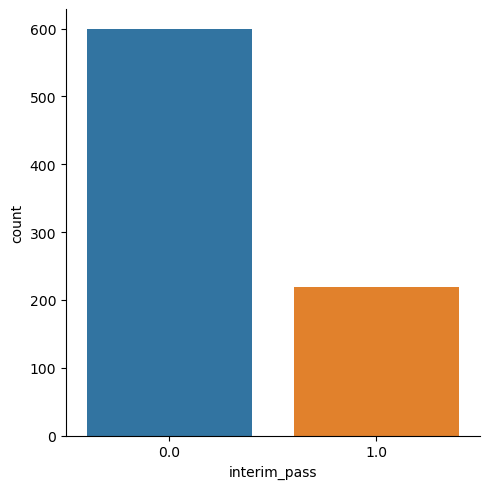

In [34]:
sns.catplot(data = interim_sqrt_df.loc[interim_sqrt_df['sess']==6], x='interim_pass', kind='count')

plt.show()

In [35]:
interim_sqrt_df.loc[interim_sqrt_df['sess']==6].interim_pass.mean()

0.26772616136919314

In [36]:
interim_sqrt_lf = interim_sqrt_df.melt(id_vars=['sess', 'sid', 'actv_grp', 'interim_scr', 'max_interim_scr', 'interim_pass'], value_vars=feature_names, ignore_index=True)

In [37]:
interim_sqrt_lf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 280434 entries, 0 to 280433
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   sess             280434 non-null  int64  
 1   sid              280434 non-null  int64  
 2   actv_grp         280434 non-null  object 
 3   interim_scr      280434 non-null  float64
 4   max_interim_scr  280434 non-null  float64
 5   interim_pass     280434 non-null  float64
 6   variable         280434 non-null  object 
 7   value            280434 non-null  float64
dtypes: float64(4), int64(2), object(2)
memory usage: 17.1+ MB


In [38]:
sns.displot(data = interim_sqrt_lf, x='value', kind='hist', col='sess', 
            row='variable', facet_kws={'sharey': False, 'sharex': False},
            bins=15)

plt.show()

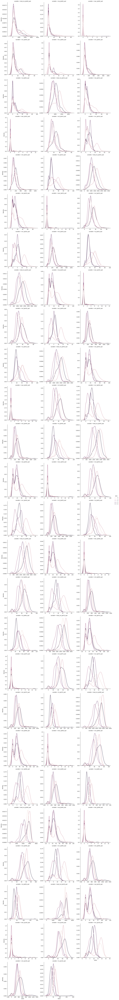

In [39]:
sns.displot(data = interim_sqrt_lf, x='value', hue='sess', col='variable', kind='kde',
            col_wrap=3, common_norm=False,
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

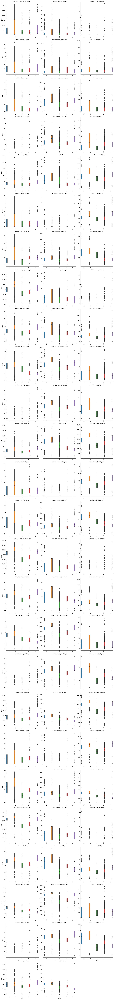

In [40]:
sns.catplot(data = interim_sqrt_lf, x='sess', y='value', col='variable', 
            col_wrap=3, hue='sess', 
            sharex=False, sharey=False, kind='box')

plt.show()

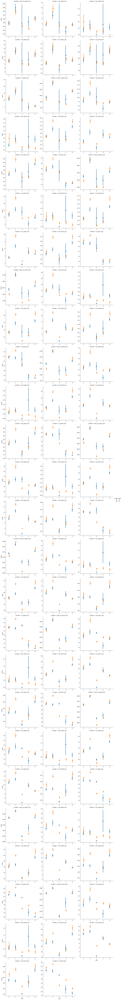

In [41]:
sns.catplot(data = interim_sqrt_lf, x='sess', y='value', hue='interim_pass',
            col='variable', kind='point', col_wrap=3, sharex=False,
            sharey=False, join=False, errorbar=('ci', 95), dodge=True)

plt.show()

In [42]:
sns.catplot(data = interim_sqrt_lf, x='sess', y='value', hue='interim_pass', col='actv_grp', 
            row='variable', kind='point', sharex=False,
            sharey=False, join=False, errorbar=('ci', 95), dodge=True)

plt.show()

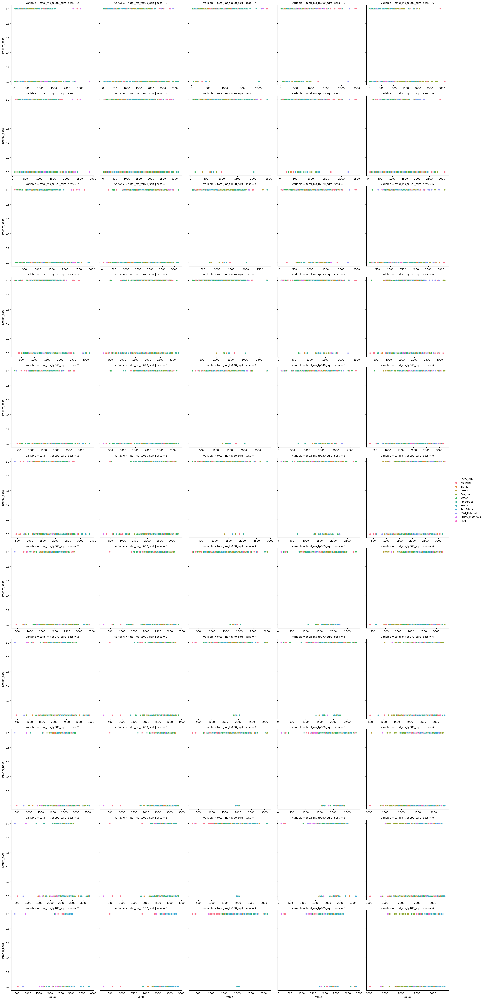

In [43]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(totl_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

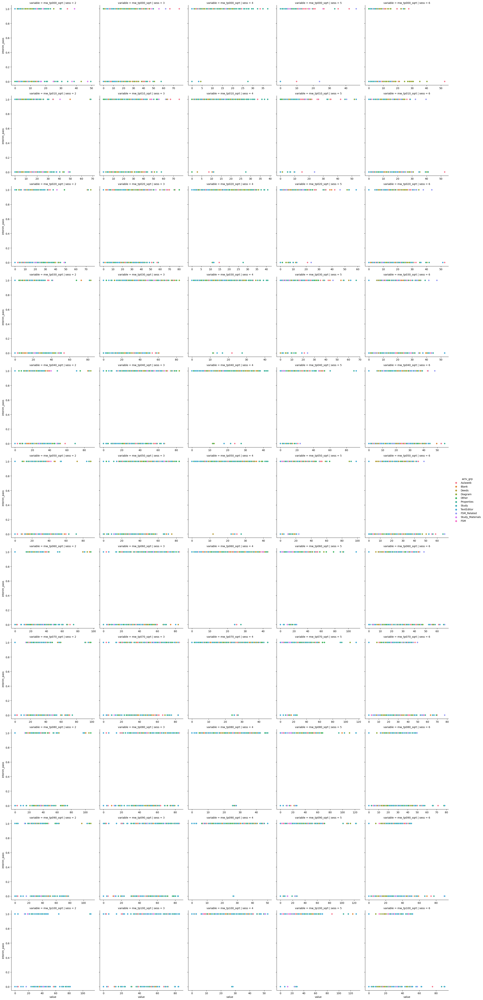

In [44]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(mw_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

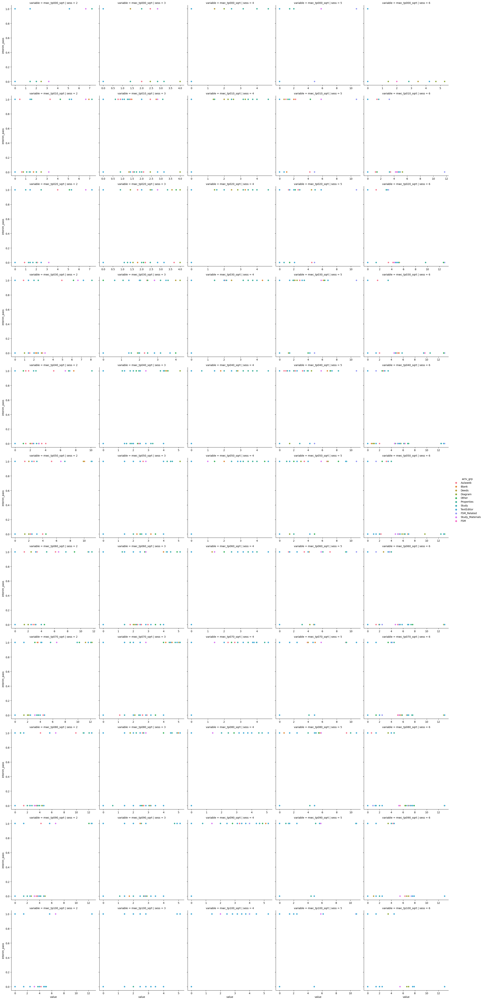

In [45]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(mwc_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

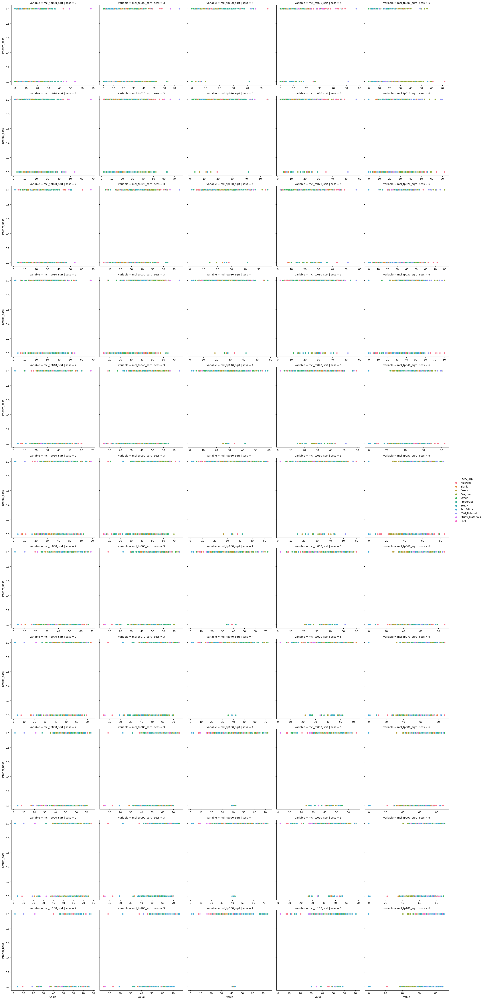

In [46]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(mcl_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

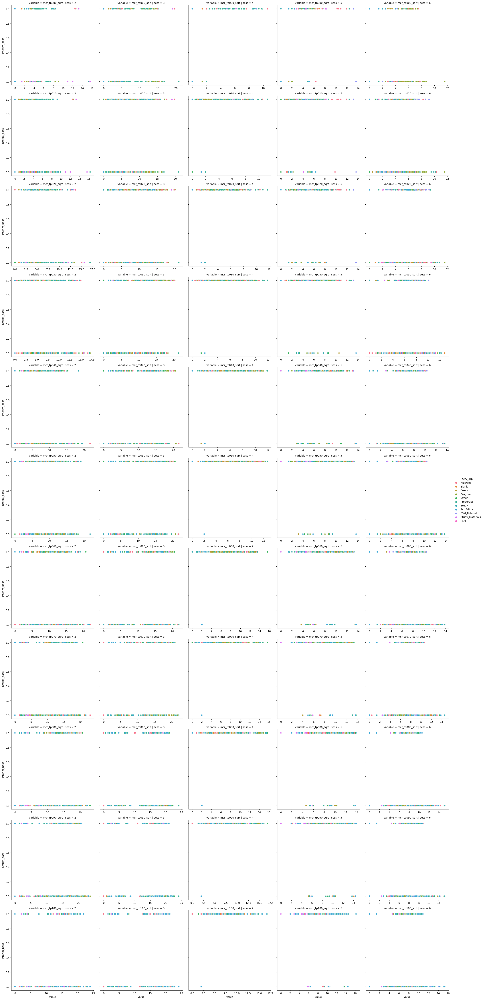

In [47]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(mcr_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

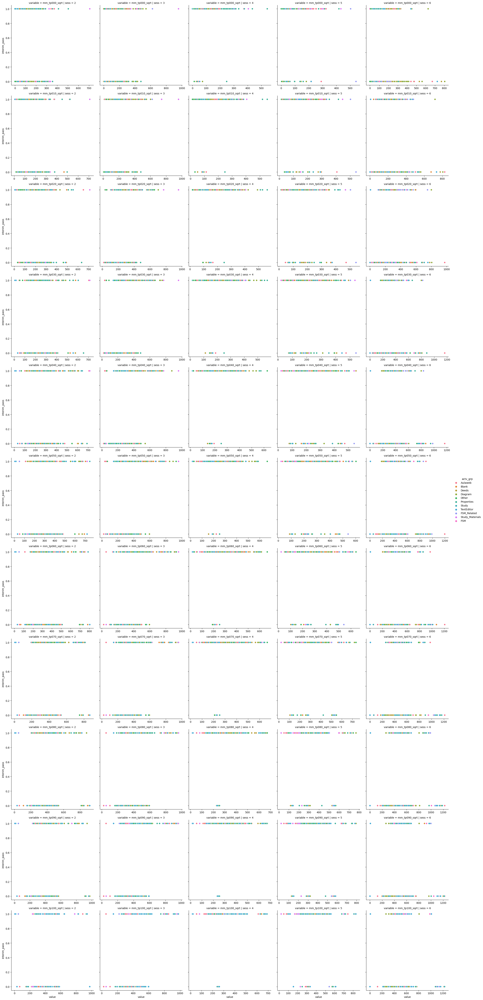

In [48]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(mm_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()

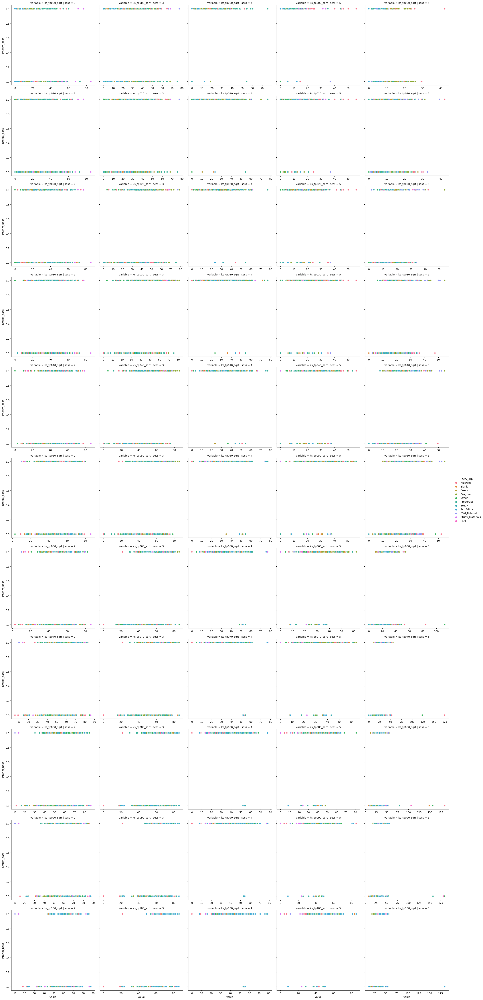

In [49]:
sns.relplot(data = interim_sqrt_lf.loc[interim_sqrt_lf['variable'].isin(ks_vars)], 
            x='value', y='interim_pass', row='variable', col='sess', kind='scatter',
            hue='actv_grp', facet_kws={'sharex': False})

plt.show()